# Data of Subsurface Snow Temperature from Noone et al

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
from glob import glob
import hvplot.pandas
import hvplot.xarray

#### Read in the subsurface snow temperature data measured by Noone et al in July 2013

In [2]:
fns = glob('/Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.201307*.cdf')
fns.sort()

In [12]:
df = pd.DataFrame({})
for fn in fns[1:]:
    print('Reading: ', fn)
    smtmet = xr.open_dataset(fn)
    time = np.array([pd.to_datetime(smtmet.base_time.values, unit='ns') + pd.Timedelta(sec, unit='m') for sec in smtmet.time_offsetd1.values]).flatten()
    ndf = pd.DataFrame({'SnowThermistor1':  smtmet.SnowThermistor1.values,
                        'SnowThermistor2':  smtmet.SnowThermistor2.values,
                        'SnowThermistor3':  smtmet.SnowThermistor3.values,
                        'SnowThermistor4':  smtmet.SnowThermistor4.values,
                        'SnowThermistor5':  smtmet.SnowThermistor5.values,
                        'SnowThermistor6':  smtmet.SnowThermistor6.values,
                        'SnowThermistor7':  smtmet.SnowThermistor7.values,
                        'SnowThermistor8':  smtmet.SnowThermistor8.values,
                        'SnowThermistor9':  smtmet.SnowThermistor9.values,
                        'SnowThermistor10': smtmet.SnowThermistor10.values,
                        'SnowThermistor11': smtmet.SnowThermistor11.values,
                        'SnowThermistor12': smtmet.SnowThermistor12.values,
                        'SnowThermistor13': smtmet.SnowThermistor13.values,
                        'SnowThermistor14': smtmet.SnowThermistor14.values}, index=time)
    df = pd.concat([df, ndf])

# ....Remove missing values
df[df==-9999.] = np.nan

Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130702.000000.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130703.000000.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130704.000100.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130705.000000.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130706.000100.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130707.000000.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130708.000000.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130709.000000.cdf
Reading:  /Users/vonw/work/projects/icecaps/analysis/Summit-Melt

In [4]:
df.hvplot(width=1000, height=600, grid=True, title='Snow Thermistor data from Summit, Noone et al - July 2013')

:NdOverlay   [Variable]
   :Curve   [index]   (value)

In [186]:
df.loc['2013-07-03':'2013-07-06'].hvplot(width=1000, height=600, grid=True, title='Snow Thermistor data from Summit, Noone et al - July 2013')

:NdOverlay   [Variable]
   :Curve   [index]   (value)

#### A quick look at the lag times for sensors at different depths shows that:

| Sensor | Depth | Lag Time |
| --   | -- | -- |
| 7 | 0.5 cm | 0 hours | 
| 8 | 20 cm | 4 hours | 
| 9 | 40 cm | 12 hours | 
| >=10 | >=50 cm | ??? |


#### Choose 2019-07-04 18:23 as the time to use for model initialization

- I'm assuming that the snow temperature profile will be similar at this time as it was during the 2019 melt events.

- Also I'm estimating that the advection-diffusion model will need to run for a couple of days for the snow pack to "forget" the initial state (T profile).

In [230]:
tmp['time'] = np.array([pd.to_datetime(tmp.base_time.values, unit='ns') + pd.Timedelta(sec, unit='m') for sec in tmp.time_offsetd1.values]).flatten()

In [235]:
tmp.sel(time='2013-07-04 18:23:00').snow_thermistor_depth.values.shape

(14, 1440)

In [240]:
tmp.sel(time='2013-07-04 00').snow_thermistor_depth.values.shape

(14, 1440)

In [223]:
ind = 18*60 + 23
print(ind)
tmp.isel(time_offsetd1=ind).snow_thermistor_depth.values

1103


array([[ 198.6633 ,  198.66301,  198.66272, ...,  198.24036,  198.24007,
         198.23976],
       [  98.66331,   98.66301,   98.66271, ...,   98.24036,   98.24006,
          98.23977],
       [  78.66331,   78.66301,   78.66271, ...,   78.24036,   78.24006,
          78.23977],
       ...,
       [-101.33669, -101.33699, -101.33729, ..., -101.75964, -101.75994,
        -101.76023],
       [-151.3367 , -151.33699, -151.33728, ..., -151.75964, -151.75993,
        -151.76024],
       [-201.3367 , -201.33699, -201.33728, ..., -201.75964, -201.75993,
        -201.76024]], dtype=float32)

In [242]:
dir(tmp)

['Contact',
 'Date_Created',
 'IR_temp',
 'IR_tempd1',
 'README',
 'RH10m',
 'RH10md1',
 'RH2m',
 'RH2md1',
 'SnowThermistor1',
 'SnowThermistor10',
 'SnowThermistor10d1',
 'SnowThermistor11',
 'SnowThermistor11d1',
 'SnowThermistor12',
 'SnowThermistor12d1',
 'SnowThermistor13',
 'SnowThermistor13d1',
 'SnowThermistor14',
 'SnowThermistor14d1',
 'SnowThermistor1d1',
 'SnowThermistor2',
 'SnowThermistor2d1',
 'SnowThermistor3',
 'SnowThermistor3d1',
 'SnowThermistor4',
 'SnowThermistor4d1',
 'SnowThermistor5',
 'SnowThermistor5d1',
 'SnowThermistor6',
 'SnowThermistor6d1',
 'SnowThermistor7',
 'SnowThermistor7d1',
 'SnowThermistor8',
 'SnowThermistor8d1',
 'SnowThermistor9',
 'SnowThermistor9d1',
 'Source',
 'T10m',
 'T10md1',
 'T2m',
 'T2md1',
 '_HANDLED_TYPES',
 '__abs__',
 '__abstractmethods__',
 '__add__',
 '__and__',
 '__annotations__',
 '__array__',
 '__array_priority__',
 '__array_ufunc__',
 '__bool__',
 '__class__',
 '__class_getitem__',
 '__contains__',
 '__copy__',
 '__dask_g

In [244]:
tmp = xr.open_dataset('/Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130704.000100.cdf')
#tmp = tmp.snow_thermistor_depth.to_dataframe()
profile = pd.DataFrame({'Depth': tmp.snow_thermistor_depth.values,
                        'Temperature': df.loc['2013-07-04 18:23:00'].values})
profile.hvplot()

In [248]:
df

,SnowThermistor1,SnowThermistor2,SnowThermistor3,SnowThermistor4,SnowThermistor5,SnowThermistor6,SnowThermistor7,SnowThermistor8,SnowThermistor9,SnowThermistor10,SnowThermistor11,SnowThermistor12,SnowThermistor13,SnowThermistor14
2013-07-02 00:01:00,-21.030130,-21.302370,-20.935720,-21.091141,-20.908440,-21.219721,-22.031170,-13.38577,-15.23055,-17.491461,-19.969179,-21.709801,-25.602039,-27.966619
2013-07-02 00:02:00,-21.108570,-21.386471,-21.036341,-21.174700,-20.986601,-21.302361,-22.082439,-13.38782,-15.22945,-17.491440,-19.967960,-21.705980,-25.603460,-27.965040
2013-07-02 00:03:00,-21.187189,-21.472040,-21.124769,-21.254740,-21.067440,-21.381430,-22.133820,-13.39090,-15.23267,-17.492559,-19.970360,-21.707239,-25.603451,-27.969740
2013-07-02 00:04:00,-21.271000,-21.562880,-21.217180,-21.336210,-21.154690,-21.453131,-22.190420,-13.39503,-15.23156,-17.491409,-19.967930,-21.711029,-25.604870,-27.968149
2013-07-02 00:05:00,-21.338711,-21.646360,-21.308599,-21.421640,-21.233431,-21.541389,-22.250980,-13.39917,-15.23369,-17.493660,-19.966709,-21.707220,-25.601990,-27.966570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-07-31 23:56:00,-6.128545,-6.117340,-6.117340,-6.083700,-6.108927,-6.121073,-6.782857,-10.16107,-12.60869,-14.849900,-17.225929,-18.735229,-22.027000,-24.409809
2013-07-31 23:57:00,-6.139771,-6.117340,-6.121073,-6.094910,-6.117340,-6.139771,-6.789444,-10.16008,-12.60971,-14.852030,-17.227051,-18.734060,-22.028280,-24.408430
2013-07-31 23:58:00,-6.139771,-6.117340,-6.126668,-6.094910,-6.117340,-6.139771,-6.792267,-10.16204,-12.60869,-14.849900,-17.225929,-18.735241,-22.028280,-24.411190
2013-07-31 23:59:00,-6.139771,-6.122004,-6.132284,-6.105189,-6.117340,-6.147257,-6.796951,-10.16107,-12.60767,-14.852030,-17.228170,-18.734070,-22.028280,-24.411190


In [202]:
profile = xr.open_dataset('/Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130704.000100.cdf')
time = np.array([pd.to_datetime(profile.base_time.values, unit='ns') + pd.Timedelta(sec, unit='m') for sec in profile.time_offsetd1.values]).flatten()
profile['time'] = time
profile

<xarray.Dataset>
Dimensions:                (IR_tempd1: 1440, RH10md1: 1440, RH2md1: 1440, SnowThermistor10d1: 1440, SnowThermistor11d1: 1440, SnowThermistor12d1: 1440, SnowThermistor13d1: 1440, SnowThermistor14d1: 1440, SnowThermistor1d1: 1440, SnowThermistor2d1: 1440, SnowThermistor3d1: 1440, SnowThermistor4d1: 1440, SnowThermistor5d1: 1440, SnowThermistor6d1: 1440, SnowThermistor7d1: 1440, SnowThermistor8d1: 1440, SnowThermistor9d1: 1440, T10md1: 1440, T2md1: 1440, altd1: 1, base_timed1: 1, cup_anemometer_heightd1: 1440, cup_anemometer_heightd2: 5, latd1: 1, lond1: 1, snow_thermistor_depthd1: 1440, snow_thermistor_depthd2: 14, sonic_distanced1: 1440, time: 1440, time_offsetd1: 1440, w1_avgd1: 1440, w1_stdd1: 1440, w2_avgd1: 1440, w2_stdd1: 1440, w3_avgd1: 1440, w3_stdd1: 1440, w4_avgd1: 1440, w4_stdd1: 1440, w5_avgd1: 1440, w5_stdd1: 1440)
Coordinates:
  * time                   (time) datetime64[ns] 2013-07-04T00:01:00 ... 2013...
Dimensions without coordinates: IR_tempd1, RH10md1, RH2md1, SnowThermistor10d1, SnowThermistor11d1, SnowThermistor12d1, SnowThermistor13d1, SnowThermistor14d1, SnowThermistor1d1, SnowThermistor2d1, SnowThermistor3d1, SnowThermistor4d1, SnowThermistor5d1, SnowThermistor6d1, SnowThermistor7d1, SnowThermistor8d1, SnowThermistor9d1, T10md1, T2md1, altd1, base_timed1, cup_anemometer_heightd1, cup_anemometer_heightd2, latd1, lond1, snow_thermistor_depthd1, snow_thermistor_depthd2, sonic_distanced1, time_offsetd1, w1_avgd1, w1_stdd1, w2_avgd1, w2_stdd1, w3_avgd1, w3_stdd1, w4_avgd1, w4_stdd1, w5_avgd1, w5_stdd1
Data variables:
    base_time              (base_timed1) timedelta64[ns] 15890 days 00:01:00
    time_offset            (time_offsetd1) timedelta64[ns] ...
    lat                    (latd1) float32 ...
    lon                    (lond1) float32 ...
    alt                    (altd1) float32 ...
    T2m                    (T2md1) float32 ...
    T10m                   (T10md1) float32 ...
    RH2m                   (RH2md1) float32 ...
    RH10m                  (RH10md1) float32 ...
    w1_avg                 (w1_avgd1) float32 ...
    w1_std                 (w1_stdd1) float32 ...
    w2_avg                 (w2_avgd1) float32 ...
    w2_std                 (w2_stdd1) float32 ...
    w3_avg                 (w3_avgd1) float32 ...
    w3_std                 (w3_stdd1) float32 ...
    w4_avg                 (w4_avgd1) float32 ...
    w4_std                 (w4_stdd1) float32 ...
    w5_avg                 (w5_avgd1) float32 ...
    w5_std                 (w5_stdd1) float32 ...
    IR_temp                (IR_tempd1) float32 ...
    sonic_distance         (sonic_distanced1) float32 ...
    SnowThermistor1        (SnowThermistor1d1) float32 ...
    SnowThermistor2        (SnowThermistor2d1) float32 ...
    SnowThermistor3        (SnowThermistor3d1) float32 ...
    SnowThermistor4        (SnowThermistor4d1) float32 ...
    SnowThermistor5        (SnowThermistor5d1) float32 ...
    SnowThermistor6        (SnowThermistor6d1) float32 ...
    SnowThermistor7        (SnowThermistor7d1) float32 ...
    SnowThermistor8        (SnowThermistor8d1) float32 ...
    SnowThermistor9        (SnowThermistor9d1) float32 ...
    SnowThermistor10       (SnowThermistor10d1) float32 ...
    SnowThermistor11       (SnowThermistor11d1) float32 ...
    SnowThermistor12       (SnowThermistor12d1) float32 ...
    SnowThermistor13       (SnowThermistor13d1) float32 ...
    SnowThermistor14       (SnowThermistor14d1) float32 ...
    snow_thermistor_depth  (snow_thermistor_depthd2, snow_thermistor_depthd1) float32 ...
    cup_anemometer_height  (cup_anemometer_heightd2, cup_anemometer_heightd1) float32 ...
Attributes:
    Date_Created:  30-Sep-2014
    Source:        Climate Processes Research Group (CPRG) - Cooperative Inst...
    Contact:       Dr. David Noone (P.I.), dcn@coas.oregonstate.edu; Dr. Chri...
    README:        NOTE: This data set is preliminary and should not be redis...

In [204]:
#profile.sel(time='2019-07-04 18:23:00')

profile.SnowThermistor1.hvplot.line()

:Curve   [index]   (SnowThermistor1)

In [151]:
# Vertical profile of snow temperature at 2013-07-15 00:16:43
profile = np.array([-5.875697,-7.139562,-6.283803,-6.349299,-5.668940,-5.403992,-5.996933,-11.99164,-15.42153,-18.034380,-20.388781,-21.772511,-24.928379,-27.305639])
profile
prf = pd.DataFrame({'T': profile}, index=smtmet.snow_thermistor_depth[:,0])
prf.hvplot.scatter()

:Scatter   [snow_thermistor_depth]   (T)

In [150]:
smtmet.snow_thermistor_depth[:,0]

<xarray.DataArray 'snow_thermistor_depth' (snow_thermistor_depthd2: 14)>
array([ 189.68752 ,   89.687515,   69.687515,   49.68752 ,   29.68752 ,
          9.687518,  -10.312482,  -30.31248 ,  -50.31248 ,  -70.312485,
        -90.312485, -110.312485, -160.31248 , -210.31248 ], dtype=float32)
Dimensions without coordinates: snow_thermistor_depthd2
Attributes:
    long_name:  Snow thermistor string depth, corrected for changing surface ...
    units:      m

### Determine the mean annual temperature (averaged over 10 years of ICECAPS)

In [14]:
sfcmet = xr.open_dataset('/Users/vonw/data/summit/sfcmet/noaamet/met_sum_insitu_1_obop_minute_2010_4-2020_3.nc')
print('Mean Annual 2-m Temperature: ', sfcmet['temperature at 2 meters'].mean().values)

Mean Annual 2-m Temperature:  -28.764837656319635


#### Determine the monthly average temperature at depth in snow pack (X meters)

In [19]:
smtmet = xr.open_dataset(fns[1])
smtmet.SnowThermistor1.hvplot() * smtmet.SnowThermistor14.hvplot()

:Overlay
   .NdOverlay.I  :NdOverlay   [Element]
      :Histogram   [SnowThermistor1]   (SnowThermistor1_count)
   .NdOverlay.II :NdOverlay   [Element]
      :Histogram   [SnowThermistor14]   (SnowThermistor14_count)

In [16]:
print('Mean Annual 2-m Temperature: ', smtmet.SnowThermistor14.mean().values)

Mean Annual 2-m Temperature:  -27.878622


This within 1 K of the mean annual surface temperature

In [149]:
smtmet

<xarray.Dataset>
Dimensions:                (IR_tempd1: 1440, RH10md1: 1440, RH2md1: 1440, SnowThermistor10d1: 1440, SnowThermistor11d1: 1440, SnowThermistor12d1: 1440, SnowThermistor13d1: 1440, SnowThermistor14d1: 1440, SnowThermistor1d1: 1440, SnowThermistor2d1: 1440, SnowThermistor3d1: 1440, SnowThermistor4d1: 1440, SnowThermistor5d1: 1440, SnowThermistor6d1: 1440, SnowThermistor7d1: 1440, SnowThermistor8d1: 1440, SnowThermistor9d1: 1440, T10md1: 1440, T2md1: 1440, altd1: 1, base_timed1: 1, cup_anemometer_heightd1: 1440, cup_anemometer_heightd2: 5, latd1: 1, lond1: 1, snow_thermistor_depthd1: 1440, snow_thermistor_depthd2: 14, sonic_distanced1: 1440, time_offsetd1: 1440, w1_avgd1: 1440, w1_stdd1: 1440, w2_avgd1: 1440, w2_stdd1: 1440, w3_avgd1: 1440, w3_stdd1: 1440, w4_avgd1: 1440, w4_stdd1: 1440, w5_avgd1: 1440, w5_stdd1: 1440)
Dimensions without coordinates: IR_tempd1, RH10md1, RH2md1, SnowThermistor10d1, SnowThermistor11d1, SnowThermistor12d1, SnowThermistor13d1, SnowThermistor14d1, SnowThermistor1d1, SnowThermistor2d1, SnowThermistor3d1, SnowThermistor4d1, SnowThermistor5d1, SnowThermistor6d1, SnowThermistor7d1, SnowThermistor8d1, SnowThermistor9d1, T10md1, T2md1, altd1, base_timed1, cup_anemometer_heightd1, cup_anemometer_heightd2, latd1, lond1, snow_thermistor_depthd1, snow_thermistor_depthd2, sonic_distanced1, time_offsetd1, w1_avgd1, w1_stdd1, w2_avgd1, w2_stdd1, w3_avgd1, w3_stdd1, w4_avgd1, w4_stdd1, w5_avgd1, w5_stdd1
Data variables:
    base_time              (base_timed1) timedelta64[ns] 15917 days 00:01:00
    time_offset            (time_offsetd1) timedelta64[ns] 00:00:00 ... 23:59...
    lat                    (latd1) float32 72.57717
    lon                    (lond1) float32 -38.45144
    alt                    (altd1) float32 3209.0
    T2m                    (T2md1) float32 -9.36 -9.33 -9.23 ... -6.104 -6.12
    T10m                   (T10md1) float32 -10.34 -10.32 ... -6.372 -6.338
    RH2m                   (RH2md1) float32 78.58 77.49 77.36 ... 91.8 91.7 92.4
    RH10m                  (RH10md1) float32 84.2 84.3 84.4 ... 94.1 93.7 93.5
    w1_avg                 (w1_avgd1) float32 1.047 0.994 0.952 ... 5.42 5.255
    w1_std                 (w1_stdd1) float32 0.013 0.022 0.009 ... 0.319 0.605
    w2_avg                 (w2_avgd1) float32 0.649 0.534 0.526 ... 4.852 4.674
    w2_std                 (w2_stdd1) float32 0.014 0.027 0.053 ... 0.392 0.549
    w3_avg                 (w3_avgd1) float32 0.545 0.438 0.399 ... 4.917 4.778
    w3_std                 (w3_stdd1) float32 0.019 0.034 0.022 ... 0.354 0.518
    w4_avg                 (w4_avgd1) float32 1.24 1.136 0.96 ... 5.613 5.557
    w4_std                 (w4_stdd1) float32 0.018 0.041 0.026 ... 0.399 0.577
    w5_avg                 (w5_avgd1) float32 0.892 0.852 0.975 ... 5.765 5.649
    w5_std                 (w5_stdd1) float32 0.05 0.057 0.108 ... 0.424 0.511
    IR_temp                (IR_tempd1) float32 -12.43936 -12.41483 ... -6.376343
    sonic_distance         (sonic_distanced1) float32 91.687515 ... 89.08493
    SnowThermistor1        (SnowThermistor1d1) float32 -10.71868 ... -6.141642
    SnowThermistor2        (SnowThermistor2d1) float32 -11.06921 ... -6.137899
    SnowThermistor3        (SnowThermistor3d1) float32 -11.03152 ... -6.139771
    SnowThermistor4        (SnowThermistor4d1) float32 -11.0216 ... -6.11734
    SnowThermistor5        (SnowThermistor5d1) float32 -10.98885 ... -6.12293
    SnowThermistor6        (SnowThermistor6d1) float32 -11.10797 ... -6.158478
    SnowThermistor7        (SnowThermistor7d1) float32 -8.708389 ... -6.799764
    SnowThermistor8        (SnowThermistor8d1) float32 -10.7088 ... -10.16107
    SnowThermistor9        (SnowThermistor9d1) float32 -12.65149 ... -12.60767
    SnowThermistor10       (SnowThermistor10d1) float32 -14.86053 ... -14.85096
    SnowThermistor11       (SnowThermistor11d1) float32 -17.31694 ... -17.22705
    SnowThermistor12       (SnowThermistor12d1) float32 -18.8695 ... -18.73523
  

In [154]:
pd.to_datetime(smtmet.base_time.values, unit='ns')

DatetimeIndex(['2013-07-31 00:01:00'], dtype='datetime64[ns]', freq=None)

#### Compare the depth of the snow sensor in July 2013

In [155]:
smtmet_20190702 = xr.open_dataset('/Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130702.000000.cdf')
smtmet_20190731 = xr.open_dataset('/Users/vonw/work/projects/icecaps/analysis/Summit-Melt-Events/data/NooneEtAl/smtmet.qc.20130731.000000.cdf')

In [158]:
smtmet_20190702.snow_thermistor_depth.values[:,0]

array([ 199.51097  ,   99.51096  ,   79.51096  ,   59.510967 ,
         39.510967 ,   19.510967 ,   -0.4890332,  -20.489033 ,
        -40.489033 ,  -60.489033 ,  -80.48904  , -100.48904  ,
       -150.48903  , -200.48903  ], dtype=float32)

In [159]:
smtmet_20190731.snow_thermistor_depth.values[:,0]

array([ 189.68752 ,   89.687515,   69.687515,   49.68752 ,   29.68752 ,
          9.687518,  -10.312482,  -30.31248 ,  -50.31248 ,  -70.312485,
        -90.312485, -110.312485, -160.31248 , -210.31248 ], dtype=float32)

The thermistors are about 10 cm deeper in the snow at the end of July 2013, relative to the beginning of July.

#### Plot the highest thermistor, which is about .2 meters above the surface for July 2013; near-surface air temperature

In [165]:
df['2013-07-04'].SnowThermistor1.hvplot.line()

:Curve   [index]   (SnowThermistor1)

In [161]:
df.SnowThermistor1

2013-07-02 00:01:00   -21.030130
2013-07-02 00:01:01   -21.108570
2013-07-02 00:01:02   -21.187189
2013-07-02 00:01:03   -21.271000
2013-07-02 00:01:04   -21.338711
                         ...    
2013-07-31 00:24:55    -6.128545
2013-07-31 00:24:56    -6.139771
2013-07-31 00:24:57    -6.139771
2013-07-31 00:24:58    -6.139771
2013-07-31 00:24:59    -6.141642
Name: SnowThermistor1, Length: 38878, dtype: float32

In [166]:
24*60

1440

In [170]:
xr.open_dataset?

Signature:
xr.open_dataset(
    filename_or_obj,
    group=None,
    decode_cf=True,
    mask_and_scale=None,
    decode_times=True,
    autoclose=None,
    concat_characters=True,
    decode_coords=True,
    engine=None,
    chunks=None,
    lock=None,
    cache=None,
    drop_variables=None,
    backend_kwargs=None,
    use_cftime=None,
    decode_timedelta=None,
)
Docstring:
Open and decode a dataset from a file or file-like object.

Parameters
----------
filename_or_obj : str, Path, file or xarray.backends.*DataStore
    Strings and Path objects are interpreted as a path to a netCDF file
    or an OpenDAP URL and opened with python-netCDF4, unless the filename
    ends with .gz, in which case the file is gunzipped and opened with
    scipy.io.netcdf (only netCDF3 supported). Byte-strings or file-like
    objects are opened by scipy.io.netcdf (netCDF3) or h5py (netCDF4/HDF).
group : str, optional
    Path to the netCDF4 group in the given file to open (only works for
    netCDF4 fil

In [15]:
smtmet

<xarray.Dataset>
Dimensions:                (IR_tempd1: 1440, RH10md1: 1440, RH2md1: 1440, SnowThermistor10d1: 1440, SnowThermistor11d1: 1440, SnowThermistor12d1: 1440, SnowThermistor13d1: 1440, SnowThermistor14d1: 1440, SnowThermistor1d1: 1440, SnowThermistor2d1: 1440, SnowThermistor3d1: 1440, SnowThermistor4d1: 1440, SnowThermistor5d1: 1440, SnowThermistor6d1: 1440, SnowThermistor7d1: 1440, SnowThermistor8d1: 1440, SnowThermistor9d1: 1440, T10md1: 1440, T2md1: 1440, altd1: 1, base_timed1: 1, cup_anemometer_heightd1: 1440, cup_anemometer_heightd2: 5, latd1: 1, lond1: 1, snow_thermistor_depthd1: 1440, snow_thermistor_depthd2: 14, sonic_distanced1: 1440, time_offsetd1: 1440, w1_avgd1: 1440, w1_stdd1: 1440, w2_avgd1: 1440, w2_stdd1: 1440, w3_avgd1: 1440, w3_stdd1: 1440, w4_avgd1: 1440, w4_stdd1: 1440, w5_avgd1: 1440, w5_stdd1: 1440)
Dimensions without coordinates: IR_tempd1, RH10md1, RH2md1, SnowThermistor10d1, SnowThermistor11d1, SnowThermistor12d1, SnowThermistor13d1, SnowThermistor14d1, SnowThermistor1d1, SnowThermistor2d1, SnowThermistor3d1, SnowThermistor4d1, SnowThermistor5d1, SnowThermistor6d1, SnowThermistor7d1, SnowThermistor8d1, SnowThermistor9d1, T10md1, T2md1, altd1, base_timed1, cup_anemometer_heightd1, cup_anemometer_heightd2, latd1, lond1, snow_thermistor_depthd1, snow_thermistor_depthd2, sonic_distanced1, time_offsetd1, w1_avgd1, w1_stdd1, w2_avgd1, w2_stdd1, w3_avgd1, w3_stdd1, w4_avgd1, w4_stdd1, w5_avgd1, w5_stdd1
Data variables:
    base_time              (base_timed1) timedelta64[ns] 15917 days 00:01:00
    time_offset            (time_offsetd1) timedelta64[ns] 00:00:00 ... 23:59...
    lat                    (latd1) float32 72.57717
    lon                    (lond1) float32 -38.45144
    alt                    (altd1) float32 3209.0
    T2m                    (T2md1) float32 -9.36 -9.33 -9.23 ... -6.104 -6.12
    T10m                   (T10md1) float32 -10.34 -10.32 ... -6.372 -6.338
    RH2m                   (RH2md1) float32 78.58 77.49 77.36 ... 91.8 91.7 92.4
    RH10m                  (RH10md1) float32 84.2 84.3 84.4 ... 94.1 93.7 93.5
    w1_avg                 (w1_avgd1) float32 1.047 0.994 0.952 ... 5.42 5.255
    w1_std                 (w1_stdd1) float32 0.013 0.022 0.009 ... 0.319 0.605
    w2_avg                 (w2_avgd1) float32 0.649 0.534 0.526 ... 4.852 4.674
    w2_std                 (w2_stdd1) float32 0.014 0.027 0.053 ... 0.392 0.549
    w3_avg                 (w3_avgd1) float32 0.545 0.438 0.399 ... 4.917 4.778
    w3_std                 (w3_stdd1) float32 0.019 0.034 0.022 ... 0.354 0.518
    w4_avg                 (w4_avgd1) float32 1.24 1.136 0.96 ... 5.613 5.557
    w4_std                 (w4_stdd1) float32 0.018 0.041 0.026 ... 0.399 0.577
    w5_avg                 (w5_avgd1) float32 0.892 0.852 0.975 ... 5.765 5.649
    w5_std                 (w5_stdd1) float32 0.05 0.057 0.108 ... 0.424 0.511
    IR_temp                (IR_tempd1) float32 -12.43936 -12.41483 ... -6.376343
    sonic_distance         (sonic_distanced1) float32 91.687515 ... 89.08493
    SnowThermistor1        (SnowThermistor1d1) float32 -10.71868 ... -6.141642
    SnowThermistor2        (SnowThermistor2d1) float32 -11.06921 ... -6.137899
    SnowThermistor3        (SnowThermistor3d1) float32 -11.03152 ... -6.139771
    SnowThermistor4        (SnowThermistor4d1) float32 -11.0216 ... -6.11734
    SnowThermistor5        (SnowThermistor5d1) float32 -10.98885 ... -6.12293
    SnowThermistor6        (SnowThermistor6d1) float32 -11.10797 ... -6.158478
    SnowThermistor7        (SnowThermistor7d1) float32 -8.708389 ... -6.799764
    SnowThermistor8        (SnowThermistor8d1) float32 -10.7088 ... -10.16107
    SnowThermistor9        (SnowThermistor9d1) float32 -12.65149 ... -12.60767
    SnowThermistor10       (SnowThermistor10d1) float32 -14.86053 ... -14.85096
    SnowThermistor11       (SnowThermistor11d1) float32 -17.31694 ... -17.22705
    SnowThermistor12       (SnowThermistor12d1) float32 -18.8695 ... -18.73523
  

In [97]:
smtmet.snow_thermistor_depth[0].shape

(1440,)

In [98]:
((246/smtmet.sonic_distance[0]) * smtmet.sonic_distance).shape

(1440,)

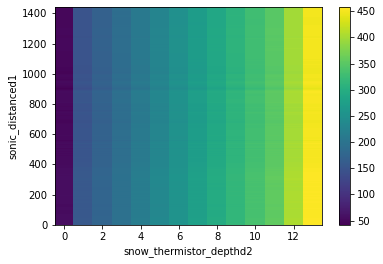

In [88]:
(((246/smtmet.sonic_distance[0]) * smtmet.sonic_distance)-smtmet.snow_thermistor_depth[:,0]).plot()

# for real use cases, its good practice to supply array attributes such as
# units, but we won't bother here for the sake of brevity
In [35]: ds = xr.Dataset(
   ....:     {
   ....:         "temperature": (["x", "y", "time"], temp),
   ....:         "precipitation": (["x", "y", "time"], precip),
   ....:     },
   ....:     coords={
   ....:         "lon": (["x", "y"], lon),
   ....:         "lat": (["x", "y"], lat),
   ....:         "time": pd.date_range("2014-09-06", periods=3),
   ....:         "reference_time": pd.Timestamp("2014-09-05"),
   ....:     },
   ....: )
   ....: 


In [110]:
time = np.array([pd.to_datetime(smtmet.base_time.values, unit='ns') + pd.Timedelta(sec, unit='m') for sec in smtmet.time_offsetd1.values]).flatten() 
#initial_height = np.concatenate([smtmet.cup_anemometer_height[:,0].values.flatten(), smtmet.snow_thermistor_depth[:,0].values.flatten()])
depth = smtmet.snow_thermistor_depth.values
SnowThermistorTemperature = np.array([smtmet.SnowThermistor1.values,
                                      smtmet.SnowThermistor2.values,
                                      smtmet.SnowThermistor3.values,
                                      smtmet.SnowThermistor4.values,
                                      smtmet.SnowThermistor5.values,
                                      smtmet.SnowThermistor6.values,
                                      smtmet.SnowThermistor7.values,
                                      smtmet.SnowThermistor8.values,
                                      smtmet.SnowThermistor9.values,
                                      smtmet.SnowThermistor10.values,
                                      smtmet.SnowThermistor11.values,
                                      smtmet.SnowThermistor12.values,
                                      smtmet.SnowThermistor13.values,
                                      smtmet.SnowThermistor14.values,
                                     ]).T

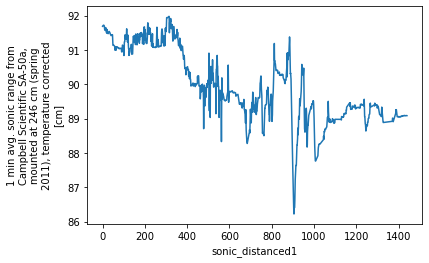

In [114]:
smtmet.sonic_distance.plot()

In [119]:
new = xr.Dataset({'T2m': (["time"], smtmet.T2m.values),
                  'T10m': (["time"], smtmet.T10m.values),
                  'RH2m': (["time"], smtmet.RH2m.values),
                  'RH10m': (["time"], smtmet.RH10m.values),
                  'SnowThermistor': (["time", "depth"], SnowThermistorTemperature),
                  'lat': smtmet.lat.values,
                  'lon': smtmet.lon.values,
                  'alt': smtmet.alt.values,
                  'reference_height': (["time"], smtmet.sonic_distance.values)
                 },
                 coords={
                     'time': time
                        })
new

<xarray.Dataset>
Dimensions:           (alt: 1, depth: 14, lat: 1, lon: 1, time: 1440)
Coordinates:
  * lat               (lat) float32 72.57717
  * lon               (lon) float32 -38.45144
  * alt               (alt) float32 3209.0
  * time              (time) datetime64[ns] 2013-07-31T00:01:00 ... 2013-08-01
Dimensions without coordinates: depth
Data variables:
    T2m               (time) float32 -9.36 -9.33 -9.23 ... -6.104 -6.104 -6.12
    T10m              (time) float32 -10.34 -10.32 -10.37 ... -6.372 -6.338
    RH2m              (time) float32 78.58 77.49 77.36 77.05 ... 91.8 91.7 92.4
    RH10m             (time) float32 84.2 84.3 84.4 84.9 ... 93.5 94.1 93.7 93.5
    SnowThermistor    (time, depth) float32 -10.71868 -11.06921 ... -24.40568
    reference_height  (time) float32 91.687515 91.69273 ... 89.08759 89.08493

In [124]:
new.lat

<xarray.DataArray 'lat' (lat: 1)>
array([72.57717], dtype=float32)
Coordinates:
  * lat      (lat) float32 72.57717

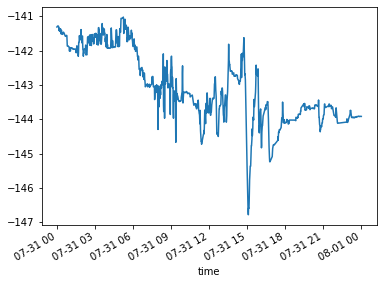

In [71]:
(new.depth[-1]+new.sonic_distance-246).plot()

In [77]:
depth[0]+new.sonic_distance[0]

<xarray.DataArray 'sonic_distance' ()>
array(281.37503, dtype=float32)
Coordinates:
    time     datetime64[ns] 2013-07-31T00:01:00